In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy import optimize
import pandas as pd
import glob

In [2]:
path_data = '/mnt/c/users/user/Desktop/Research/CV_lc_data/'
path_lc = '/mnt/c/users/user/Desktop/Research/lc/lc/CV_lc_from_MAST/'


# Savitzky-Golay Filter and Outlier Removal

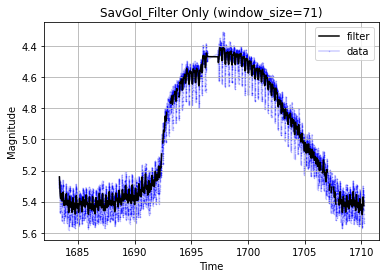

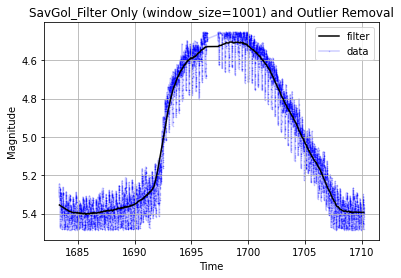

In [24]:
df = pd.read_csv(path_data + 'TIC_69559020(CV).csv')
fig, axs = plt.subplots(2)

window_length = 71
axs[0].plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', zorder=2, label='filter')
axs[0].plot(df['time'],df['mag'], color='blue', marker='*', ms=1, zorder=1, alpha=0.2, label='data')
axs[0].grid()
axs[0].legend()
axs[0].set_title('SavGol_Filter Only (window_size=%s)' % (window_length))
axs[0].set_ylabel('Magnitude')
axs[0].set_xlabel('Time')
#plt.gca().invert_yaxis()
#plt.show()

y = df['mag']
removed_outliers= y.between(y.quantile(.05), y.quantile(.95))
index_names = df[~removed_outliers].index
df.drop(index_names, inplace=True)

window_length = 1001

plt.plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', zorder=2, label='filter')
plt.plot(df['time'],df['mag'], color='blue', marker='*', ms=1, zorder=1, alpha=0.2, label='data')
plt.title('SavGol_Filter Only (window_size=%s) and Outlier Removal' % (window_length))
plt.legend()
plt.grid()
plt.ylabel('Magnitude')
plt.xlabel('Time')
plt.gca().invert_yaxis()
plt.show()

#plt.savefig(fname='/mnt/c/users/user/Desktop/ThesisFigures/savgol_example.png', bbox_inches='tight')

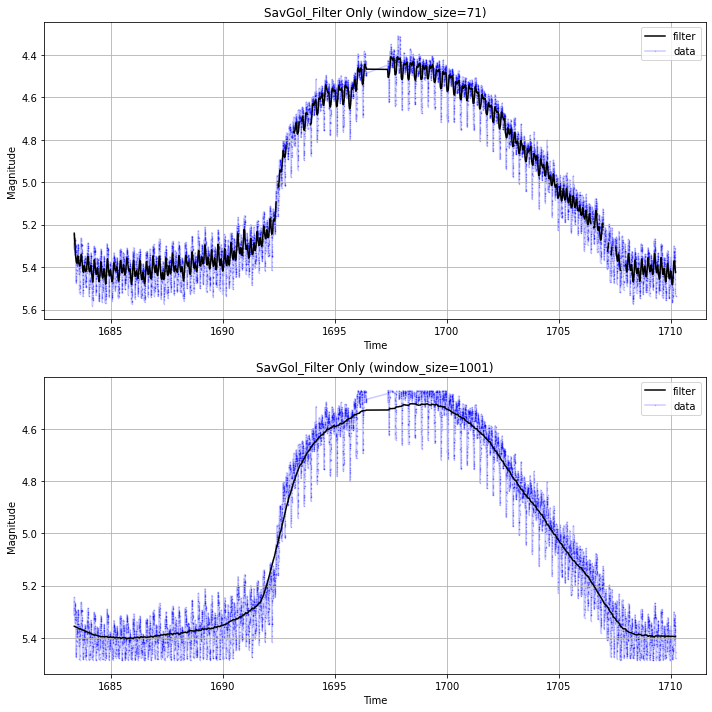

In [29]:
df = pd.read_csv(path_data + 'TIC_69559020(CV).csv')
fig, axs = plt.subplots(2, figsize=(10,10))

window_length = 71
axs[0].plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', zorder=2, label='filter')
axs[0].plot(df['time'],df['mag'], color='blue', marker='*', ms=1, zorder=1, alpha=0.2, label='data')
axs[0].grid()
axs[0].legend()
axs[0].set_title('SavGol_Filter Only (window_size=%s)' % (window_length))
axs[0].set_ylabel('Magnitude')
axs[0].set_xlabel('Time')
#plt.gca().invert_yaxis()
#plt.show()

y = df['mag']
removed_outliers= y.between(y.quantile(.05), y.quantile(.95))
index_names = df[~removed_outliers].index
df.drop(index_names, inplace=True)

window_length = 1001

axs[1].plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', zorder=2, label='filter')
axs[1].plot(df['time'],df['mag'], color='blue', marker='*', ms=1, zorder=1, alpha=0.2, label='data')
axs[1].grid()
axs[1].legend()
axs[1].set_title('SavGol_Filter Only (window_size=%s)' % (window_length))
axs[1].set_ylabel('Magnitude')
axs[1].set_xlabel('Time')
#plt.gca().invert_yaxis()
#plt.show()
for ax in axs.flat:
    ax.invert_yaxis()
#fig.suptitle('TIC_69559020(CV)', fontstyle='oblique', fontsize=30)
fig.tight_layout()
fig.savefig(fname='/mnt/c/users/user/Desktop/ThesisFigures/savgol_example.png', bbox_inches='tight')

# Savitzky-Golay and Outlier Removal (Microlensing)

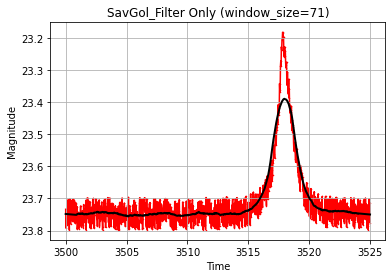

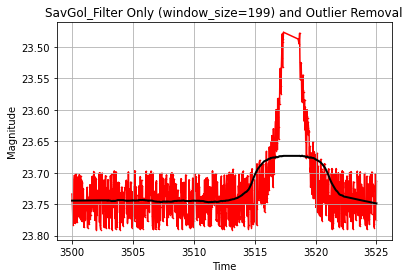

In [14]:
mulens_path_data = '/mnt/c/users/user/Desktop/Research/synth_lc_data/'

df = pd.read_csv(mulens_path_data + 't_0=3518.u_0=0.5.t_E=1.1011.s=0.7525.q=0.0752.alpha=249.rho=0.0505.csv')

window_length = 71
plt.plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', linewidth=2, zorder=2)
plt.plot(df['time'],df['mag'], color='red', marker='*', ms=1, zorder=1)
plt.grid()
plt.title('SavGol_Filter Only (window_size=%s)' % (window_length))
plt.ylabel('Magnitude')
plt.xlabel('Time')
plt.gca().invert_yaxis()
plt.show()

y = df['mag']
removed_outliers= y.between(y.quantile(.05), y.quantile(.95))
index_names = df[~removed_outliers].index
df.drop(index_names, inplace=True)

window_length = 199
plt.plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', linewidth=2, zorder=2)
plt.plot(df['time'],df['mag'], color='red', marker='*', ms=1, zorder=1)
plt.title('SavGol_Filter Only (window_size=%s) and Outlier Removal' % (window_length))
plt.grid()
plt.ylabel('Magnitude')
plt.xlabel('Time')
plt.gca().invert_yaxis()
plt.show()

# scipy.interpolate

In [3]:
from scipy import interpolate

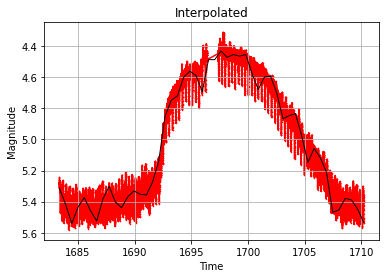

In [16]:
df = pd.read_csv(path_data + 'TIC_69559020(CV).csv')

f = interpolate.interp1d(df['time'], df['mag'], kind='zero')
x_int = np.linspace(df['time'].iloc[0], df['time'].iloc[-1], 50)
y_int = f(x_int)

plt.plot(x_int, y_int, 'k-', linewidth=1, zorder=2)
plt.plot(df['time'],df['mag'], color='red', marker='*', ms=1, zorder=1)
plt.grid()
plt.title('Interpolated')
plt.ylabel('Magnitude')
plt.xlabel('Time')
plt.gca().invert_yaxis()
plt.show()


# Median Filter and Outlier Removal

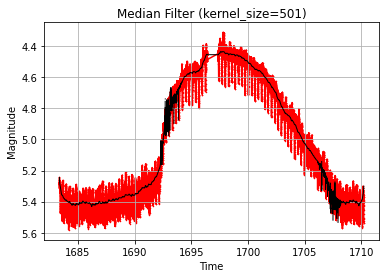

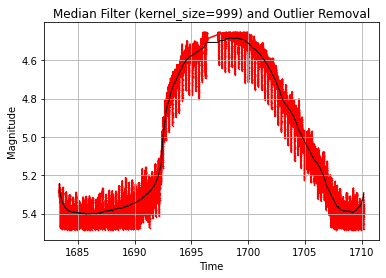

In [71]:
df = pd.read_csv(path_data + 'TIC_69559020(CV).csv')

kernel_size = 501
plt.plot(df['time'], signal.medfilt(df['mag'], kernel_size=kernel_size), 'k-', linewidth=1, zorder=2)
plt.plot(df['time'],df['mag'], color='red', marker='*', ms=1, zorder=1)
plt.grid()
plt.title('Median Filter (kernel_size=%s)' % (kernel_size))
plt.ylabel('Magnitude')
plt.xlabel('Time')
plt.gca().invert_yaxis()
plt.show()

y = df['mag']
removed_outliers= y.between(y.quantile(.05), y.quantile(.95))
index_names = df[~removed_outliers].index
df.drop(index_names, inplace=True)

kernel_size = 999
plt.plot(df['time'], signal.medfilt(df['mag'], kernel_size=kernel_size), 'k-', linewidth=1, zorder=2)
plt.plot(df['time'],df['mag'], color='red', marker='*', ms=1, zorder=1)
plt.title('Median Filter (kernel_size=%s) and Outlier Removal' % (kernel_size))
plt.grid()
plt.ylabel('Magnitude')
plt.xlabel('Time')
plt.gca().invert_yaxis()
plt.show()

# numpy.polyfit

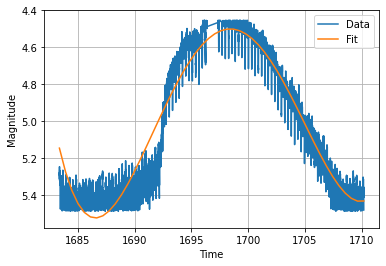

In [12]:
df = pd.read_csv(path_data + 'TIC_69559020(CV).csv')

y = df['mag']
removed_outliers= y.between(y.quantile(.05), y.quantile(.95))
index_names = df[~removed_outliers].index
df.drop(index_names, inplace=True)


z = np.polyfit(df['time'], df['mag'], 4)
f = np.poly1d(z)
time_new = np.linspace(df['time'].iloc[0], df['time'].iloc[-1], 50)
mag_new = f(time_new)

plt.plot(df['time'], df['mag'], label='Data')
plt.plot(time_new, mag_new, label='Fit')
plt.xlabel('Time')
plt.ylabel('Magnitude')
plt.gca().invert_yaxis()
plt.grid()
plt.legend()
plt.show()

# scipy.signal.filtfilt

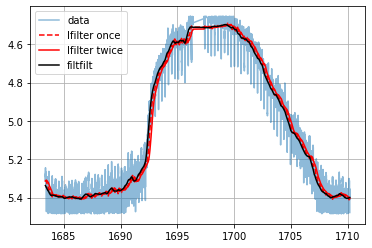

In [41]:
df = pd.read_csv(path_data + 'TIC_69559020(CV).csv')

y = df['mag']
removed_outliers= y.between(y.quantile(.05), y.quantile(.95))
index_names = df[~removed_outliers].index
df.drop(index_names, inplace=True)

b, a = signal.butter(2, 0.005)
zi = signal.lfilter_zi(b, a)
z , _ = signal.lfilter(b, a, df['mag'].values, zi=zi*df['mag'].iloc[0])
z2 , _ = signal.lfilter(b, a, z, zi=zi*z[0])

y_ = signal.filtfilt(b, a, df['mag'].values)

plt.plot(df['time'], df['mag'], label='Data', alpha = 0.5)
plt.plot(df['time'], z, 'r--', df['time'], z2, 'r', df['time'], y_, 'k')
plt.legend(('data', 'lfilter once', 'lfilter twice', 'filtfilt'))
plt.gca().invert_yaxis()
plt.grid()
plt.show()

# Loop through lc's to check plots for decent filtering


In [4]:
path = '/mnt/c/Users/User/Desktop/Research/lc_data/'
files=[]

for filepath in glob.glob(path + '*.csv'):
    #print(filepath)
    df = pd.read_csv(filepath)
    print(len(df['mag']))
    files.append(str(filepath))

986
1282
1282
1282
1282
1282
1266
1184
16781
1282
1266
1282
1282
1282
1282
1245
1282
1282
1282
1282
1282
1266
1245
1282
1266
1266
1282
1184
1266
1282
1282
1266
1266
1245
1245
1282
1282
1282
1228
1282
1245
1282
1282
1282
1282
1282
1282
1282
1184
1174
1046
1025
1282
1184
1282
1282
1282
1046
986
1196
1228
980
980
986
1282
1266
1184
1188
1188
1188
986
986
1266
1184
1282
1266
1282
1184
1266
1266
1282
1184
1282
1266
1205
1086
1086
1086
1266
1266
1266
1184
1282
1245
1184
842
1046
1228
1282
1196
1228
1282
1282
1282
1282
1282
1282
1282
1245
1245
1282
1282
1282
1282
1228
1266
1245
1282
1282
1241
880
1184
1266
1282
1282
1282
1245
1282
1282
986
986
1282
1228
1266
1282
986
1245
1228
1228
1205
1086
1245
986
986
1282
1282
1282
1282
1266
1282
1282
1282
1282
1245
1282
1282
1282
1282
1282
1245
1245
1282
1282
1282
1266
1282
1282
1282
1245
1282
1266
1266
1282
1266
1282
1282
1282
1245
1245
1148
1148
1282
1148
1148
1282
1282
1245
1148
1282
1148
1205
1266
1282
1282
1282
1245
1282
1245
1282
1282
1282
1266
124

In [6]:
files_ = files[0].split('TIC_')
files_[1]

'TIC 130414751(RRC).csv'

# Figure saving for Variable lc's with SavGol Filter

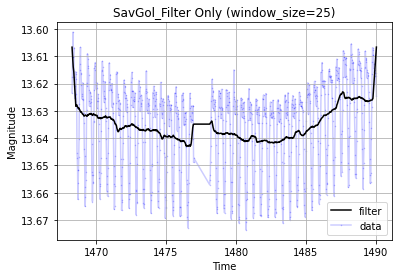

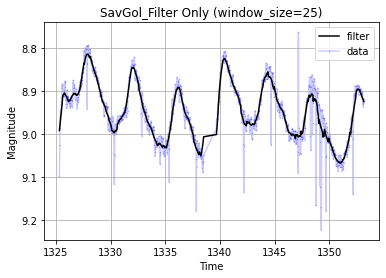

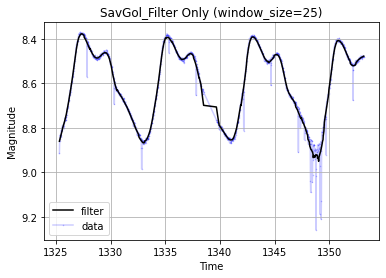

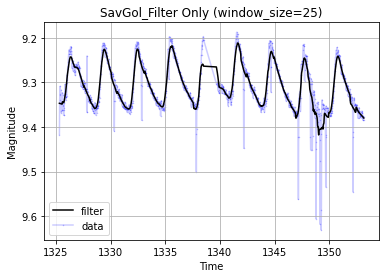

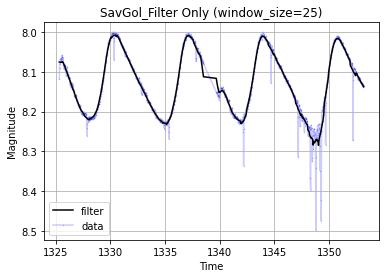

...

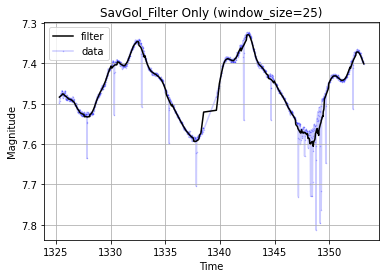

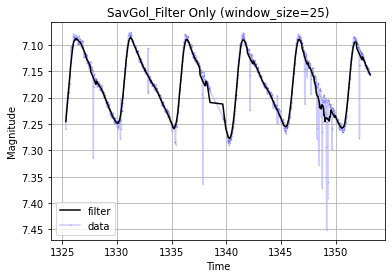

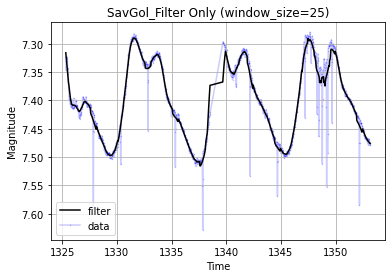

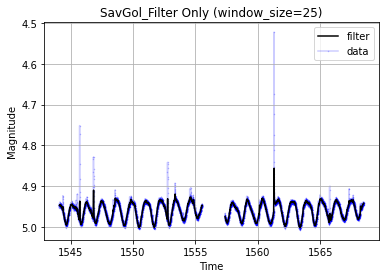

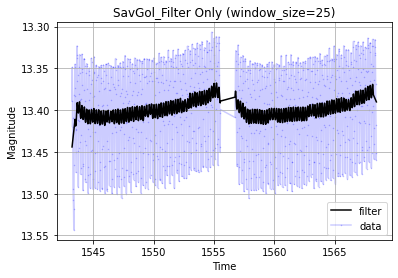

In [8]:
path = '/mnt/c/users/user/Desktop/Research/savgol_filter_lc/'

for i in range(len(files)):
    df = pd.read_csv(files[i])
    
    #y = df['mag']
    #removed_outliers= y.between(y.quantile(.01), y.quantile(.99))
    #index_names = df[~removed_outliers].index
    #df.drop(index_names, inplace=True)
    
    window_length = 25
    plt.plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', zorder=2, label='filter')
    plt.plot(df['time'],df['mag'], color='blue', marker='*', ms=1, zorder=1, alpha=0.2, label='data')
    plt.title('SavGol_Filter Only (window_size=%s)' % (window_length))
    plt.legend()
    plt.grid()
    plt.ylabel('Magnitude')
    plt.xlabel('Time')
    plt.gca().invert_yaxis()
    #plt.savefig(path+'filtered_' + files[i].split('TIC_')[1].split('.csv')[0] +'.png')
    plt.show()

In [20]:
path_data = '/mnt/c/users/user/Desktop/Research/CV_lc_data/'

files=[]

for filepath in glob.glob(path_data + '*.csv'):
    #print(filepath)
    #df = pd.read_csv(filepath)
    #print(len(df['mag']))
    files.append(str(filepath))

In [21]:
files

['/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_103439731(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_103632402(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_1201247611(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_129758136(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_139144802(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_142155545(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_142864870(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_157260715(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_165690666(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_168990573(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_173002290(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_186040332(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_186400004(CV).csv',
 '/mnt/c/users/user/Desktop/Research/CV_lc_data/TIC_190696047(C

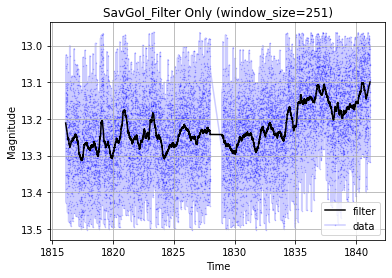

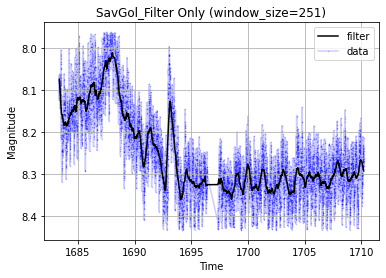

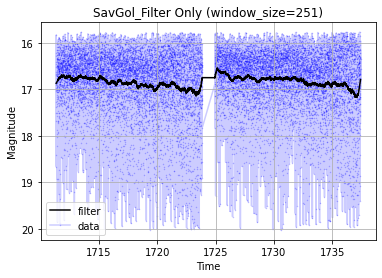

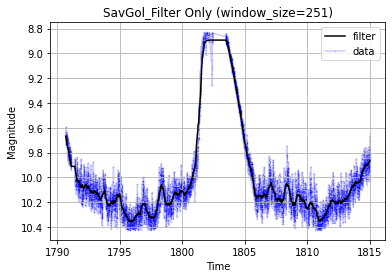

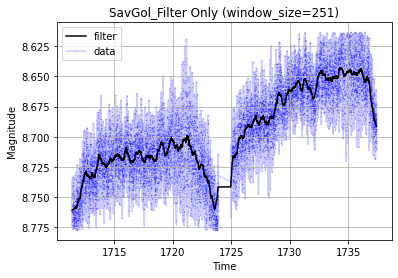

...

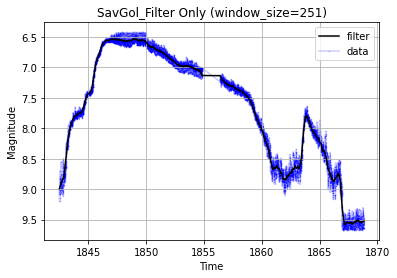

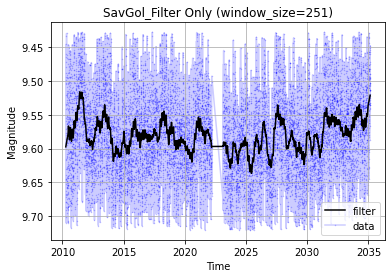

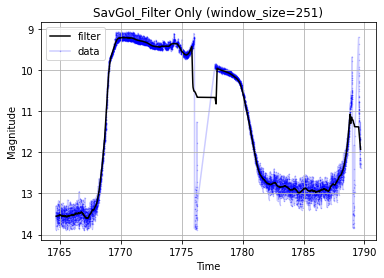

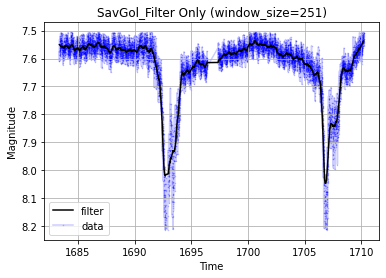

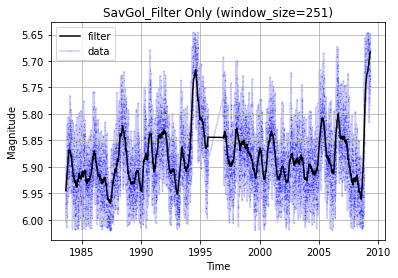

In [26]:
path = '/mnt/c/users/user/Desktop/Research/savgol_filter_cv_lc/'

for i in range(len(files)):
    df = pd.read_csv(files[i])
    
    y = df['mag']
    removed_outliers= y.between(y.quantile(.01), y.quantile(.99))
    index_names = df[~removed_outliers].index
    df.drop(index_names, inplace=True)

    window_length = 251
    plt.plot(df['time'], signal.savgol_filter(df['mag'], window_length=window_length, polyorder=1), 'k-', zorder=2, label='filter')
    plt.plot(df['time'],df['mag'], color='blue', marker='*', ms=1, zorder=1, alpha=0.2, label='data')
    plt.title('SavGol_Filter Only (window_size=%s)' % (window_length))
    plt.legend()
    plt.grid()
    plt.ylabel('Magnitude')
    plt.xlabel('Time')
    plt.gca().invert_yaxis()
    #plt.savefig(path+'filtered_' + files[i].split('CV_lc_data/')[1].split('.csv')[0] +'.png')
    plt.show()

# Data saving variable (non-CV) lc's after SavGol Filtering

In [10]:
files[1].split('TIC_')[1].split('.csv')[0]

'TIC 140860769(DCEPS)'

In [11]:
path = '/mnt/c/users/user/Desktop/savgol_filter_lc_data/'

for i in range(len(files)):
    df = pd.read_csv(files[i])
    
    filter_df = {'time': df['time'],
                'filter_mag': signal.savgol_filter(df['mag'], window_length=25, polyorder=1)}
    
    filter_df = pd.DataFrame(data=filter_df)
    
    filter_df.to_csv(path + 'filtered_' + files[i].split('TIC_')[1].split('.csv')[0] + '.csv')
   